In [1]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import plotly.express as px
import plotly.figure_factory as ff
from arch import arch_model

from ipywidgets import HBox, VBox
from scipy.optimize import fmin, minimize
from scipy.stats import t
from scipy.stats import norm
from math import inf

import bs4 as bs
import requests
import yfinance as yf
import datetime

 <img width=800 height=800 src="mark_twain.jpg"/>

# We download 10 years of price data for the members of the S&P 500

In [2]:
resp = requests.get('http://en.wikipedia.org/wiki/List_of_S%26P_500_companies')
soup = bs.BeautifulSoup(resp.text, 'lxml')
table = soup.find('table', {'class': 'wikitable sortable'})
tickers = []
for row in table.findAll('tr')[1:]:
    ticker = row.findAll('td')[0].text
    tickers.append(ticker)

tickers = [s.replace('\n', '') for s in tickers]
start = datetime.datetime(2010,1,1)
end = datetime.datetime(2020,12,30)
close_prices = yf.download(tickers, start=start, end=end)['Adj Close']

[*********************100%***********************]  505 of 505 completed

2 Failed downloads:
- BF.B: No data found for this date range, symbol may be delisted
- BRK.B: No data found, symbol may be delisted


In [3]:
close_prices.head()

,A,AAL,AAP,AAPL,ABBV,ABC,ABMD,ABT,ACN,ADBE,...,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZBRA,ZION,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2009-12-31,20.394503,4.562870,39.130402,6.492372,NaN,22.039557,8.73,19.981462,32.899128,36.779999,...,19.580618,45.705887,32.744503,16.202126,NaN,20.258904,54.542049,28.350000,11.286501,NaN
2010-01-04,20.545471,4.496876,39.033730,6.593426,NaN,22.512976,8.74,20.155407,33.350983,37.090000,...,19.830650,46.349365,32.893471,16.527702,NaN,20.328438,55.381721,28.670000,11.726357,NaN
2010-01-05,20.322292,5.005957,38.801731,6.604825,NaN,22.352354,8.53,19.992567,33.557114,37.700001,...,19.580618,46.530319,32.502430,16.546856,NaN,20.258904,57.134892,28.620001,12.139812,NaN
2010-01-06,20.250086,4.798555,39.140064,6.499768,NaN,22.141001,8.40,20.103596,33.913837,37.619999,...,19.447794,46.932491,32.716572,16.393644,NaN,20.114079,57.116451,28.400000,13.195447,NaN
2010-01-07,20.223837,4.939965,39.130402,6.487752,NaN,21.785934,8.40,20.270136,33.882126,36.889999,...,19.252451,46.785034,33.144829,16.470243,NaN,20.108288,58.426708,27.690001,14.673337,NaN


In [4]:
rets = ((close_prices / close_prices.shift(1)) - 1 ).dropna(how='all') * 100

In [5]:
rets.head()

,A,AAL,AAP,AAPL,ABBV,ABC,ABMD,ABT,ACN,ADBE,...,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZBRA,ZION,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,0.740241,-1.446312,-0.247051,1.556499,NaN,2.148043,0.114550,0.870529,1.373455,0.842853,...,1.276938,1.407868,0.454940,2.009470,NaN,0.343228,1.539495,1.128747,3.897183,NaN
2010-01-05,-1.086268,11.320767,-0.594354,0.172888,NaN,-0.713463,-2.402746,-0.807922,0.618066,1.644650,...,-1.260838,0.390413,-1.188810,0.115888,NaN,-0.342054,3.165611,-0.174396,3.525869,NaN
2010-01-06,-0.355307,-4.143108,0.871954,-1.590614,NaN,-0.945553,-1.524034,0.555350,1.063035,-0.212206,...,-0.678344,0.864323,0.658849,-0.925926,NaN,-0.714871,-0.032275,-0.768697,8.695641,NaN
2010-01-07,-0.129624,2.946936,-0.024687,-0.184858,NaN,-1.603660,0.000000,0.828410,-0.093506,-1.940456,...,-1.004448,-0.314190,1.308991,0.467249,NaN,-0.028789,2.294010,-2.499997,11.200000,NaN
2010-01-08,-0.032490,-1.908414,0.395260,0.664805,NaN,1.086525,-2.023811,0.511236,-0.397726,-0.542154,...,1.461051,-0.401136,0.000000,-0.348865,NaN,0.028798,-2.100428,-0.325028,-1.618707,NaN


In [6]:
cum_rets = close_prices / close_prices.iloc[0,:]

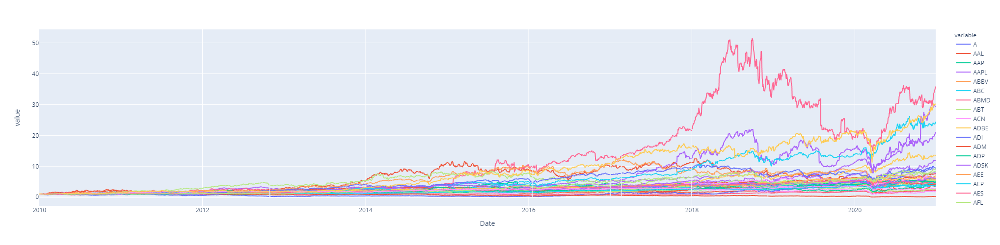

In [7]:
fig = px.line(cum_rets.iloc[:,:50], width=1000, height=500)
fig.show()

### Daily mean returns for the stocks

In [8]:
mean_rets = pd.DataFrame(rets.mean(), columns = ['Mean Return'])
mean_rets.head()

,Mean Return
A,0.079599
AAL,0.099513
AAP,0.066562
AAPL,0.126504
ABBV,0.088407


In [9]:
total_cum_rets = cum_rets.iloc[-1,:]
annual_return = np.power(total_cum_rets, 250/len(cum_rets))-1

In [10]:
annual_return = pd.DataFrame(annual_return.values*100, columns= ['Annual Return'], index = annual_return.index).dropna()

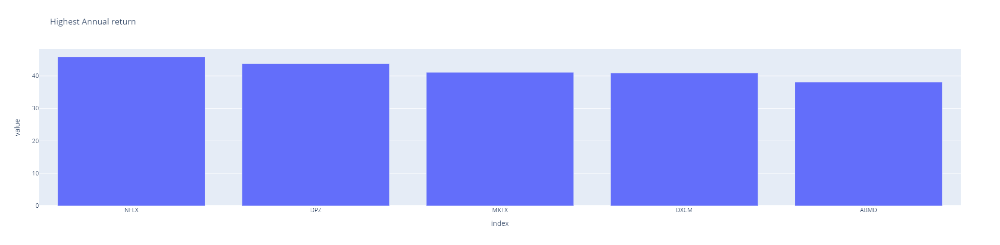

In [11]:
annual_return.sort_values(by ='Annual Return', ascending=False, inplace=True)

fig  = px.bar(annual_return.iloc[:5], title='Highest Annual return', width=1000, height=500)
fig.update_layout(showlegend=False)
fig.show()

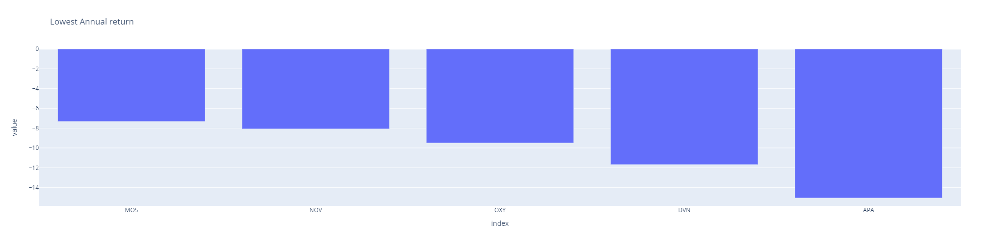

In [12]:
fig = px.bar(annual_return.iloc[-5:], title='Lowest Annual return', width=1000, height=500)
fig.update_layout(showlegend=False)
fig.show()

### Daily return volatility  for the stocks

In [13]:
vol_daily = pd.DataFrame(rets.std().dropna(),columns = ['Vol'])
vol_daily.head()

,Vol
A,1.818927
AAL,3.358869
AAP,1.959662
AAPL,1.784681
ABBV,1.792831


### Annualised vol for familiarity

In [14]:
vol_annual = pd.DataFrame(rets.std().dropna() * 16,columns = ['Vol'])
vol_annual.head()

,Vol
A,29.102832
AAL,53.741900
AAP,31.354592
AAPL,28.554888
ABBV,28.685298


In [15]:
vol_annual.sort_values(by=['Vol'], ascending=False, inplace=True)
vol_and_ret = pd.concat([vol_annual, annual_return], axis=1, sort=False, join='inner')

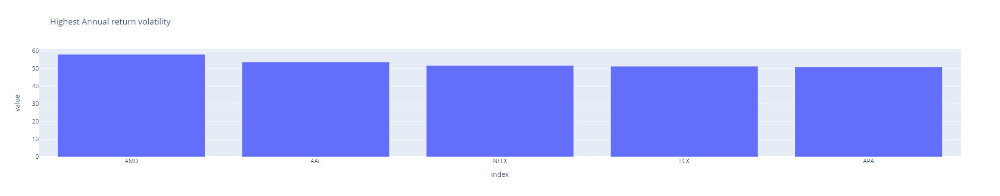

In [16]:
fig  = px.bar(vol_and_ret['Vol'][:5], title='Highest Annual return volatility', width=1000, height=400)
fig.update_layout(showlegend=False)
fig.show()

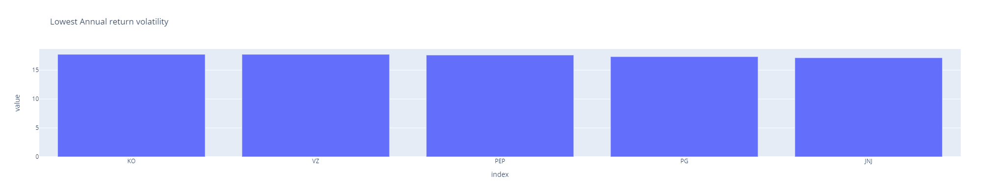

In [17]:
fig  = px.bar(vol_and_ret['Vol'][-5:], title='Lowest Annual return volatility', width=1000, height=400)
fig.update_layout(showlegend=False)
fig.show()

# Do Higher vol stocks compensate you with higher returns?

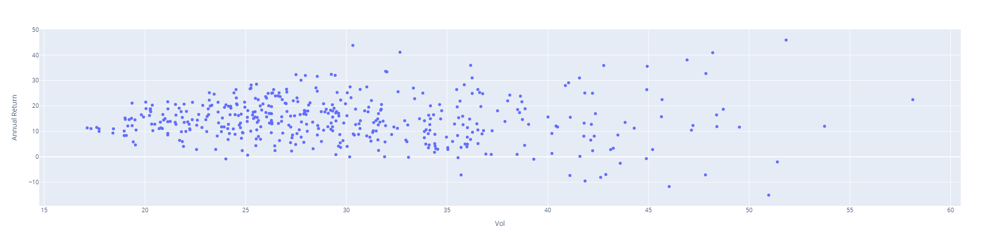

In [18]:
fig = px.scatter(vol_and_ret, x = 'Vol', y='Annual Return', width=1000, height=500, hover_name = vol_and_ret.index)
fig.show()

# The case for heteroskedastic Volatility
## Looking at a return plot for a stock, we can observe 2 phenomena;
## - Volatility Clustering
## - Non Constant Variance

In [ ]:
# dates_to_exclude = [str(x) + "-12-25" for x in rets.index.year.unique()] + \
# [str(x) + "-01-01" for x in rets.index.year.unique()] + \
# [str(x) + "-12-26" for x in rets.index.year.unique()] + \
# [str(x) + "-07-04" for x in rets.index.year.unique()] 

In [19]:
max_ret = rets[['NFLX']].max().values[0] * 1.1

In [20]:
min_ret = rets[['NFLX']].min().values[0] * 1.1

In [ ]:

# return_plot = px.bar(rets[['NFLX']], title = 'Daily Returns for Netflix', labels={'value' : 'Daily Return'}, width=1000, height=500, range_y = [min_ret,max_ret])
# return_plot.
# return_plot.update_layout(showlegend=False, bargap=0)
# return_plot.update_xaxes(
#     rangebreaks=[
#         dict(bounds=["sat", "mon"]), #hide weekends
#         dict(values=dates_to_exclude)  # hide Christmas and New Year's
#     ]
# )

# # for data in return_plot.data:
# #     data["width"] = 10
    
# return_plot.show()

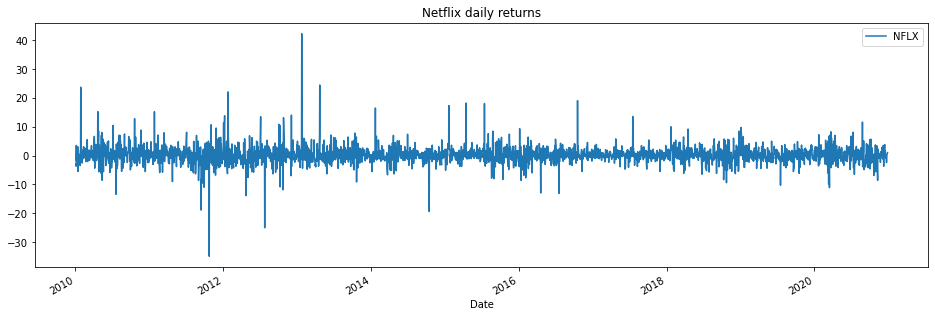

In [21]:
rets[['NFLX']].plot(figsize =(16,5), title = 'Netflix daily returns');

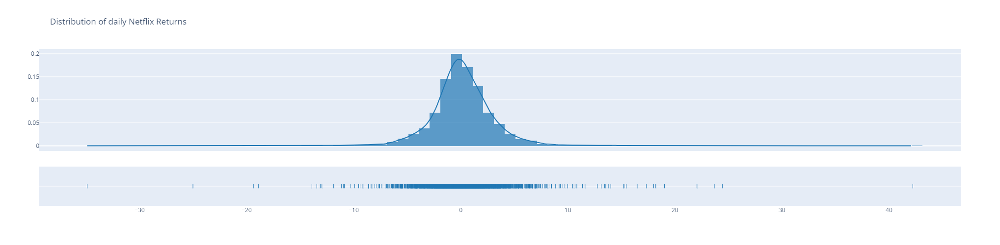

In [22]:
return_dist_plot  = ff.create_distplot([rets['NFLX'].values.reshape(-1)], group_labels = [' '])
return_dist_plot.update_layout(showlegend=False, title_text='Distribution of daily Netflix Returns', width=1000, height=500)
return_dist_plot.show()

In [23]:
sim_mean = mean_rets.loc['NFLX']
sim_std = vol_daily.loc['NFLX']
sim_rets = pd.DataFrame(np.random.normal(sim_mean, sim_std, len(rets)), columns = ['Sim Rets'], index = rets.index)
sim_rets.head()

,Sim Rets
Date,
2010-01-04,7.018056
2010-01-05,1.724562
2010-01-06,-1.426022
2010-01-07,-5.075351
2010-01-08,-2.446096


# These 2 series have the same characteristics

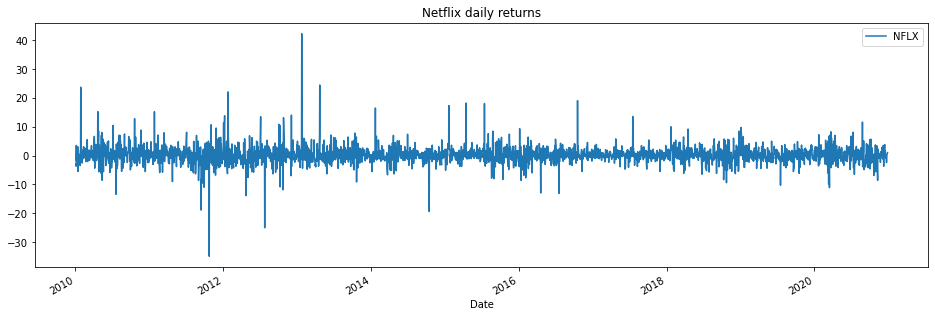

In [24]:
rets[['NFLX']].plot(figsize =(16,5), title = 'Netflix daily returns');

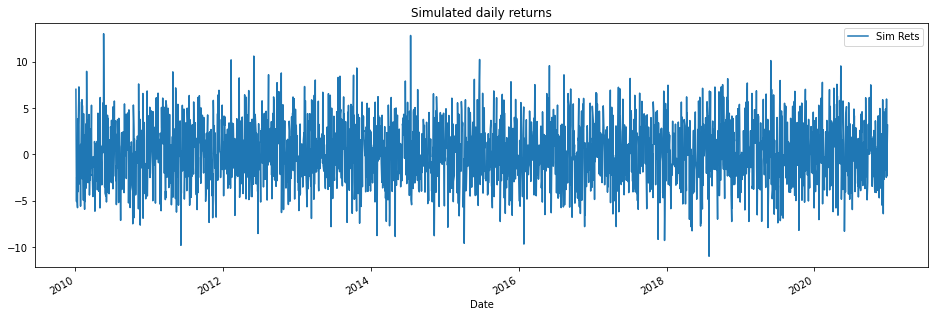

In [25]:
sim_rets.plot(figsize =(16,5), title = 'Simulated daily returns');

In [26]:
print('Volatility of Netflix is {vol}%'.format(vol =round(vol_annual.loc['NFLX'].values[0],2)))
print('Volatility of Simulated series is {vol}%'.format(vol =round(sim_rets.std().values[0]*16,2)))

Volatility of Netflix is 51.83%
Volatility of Simulated series is 52.87%


# Is there autocorrelation in the returns?

C:\Users\Tino\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:652: FutureWarning:

The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.



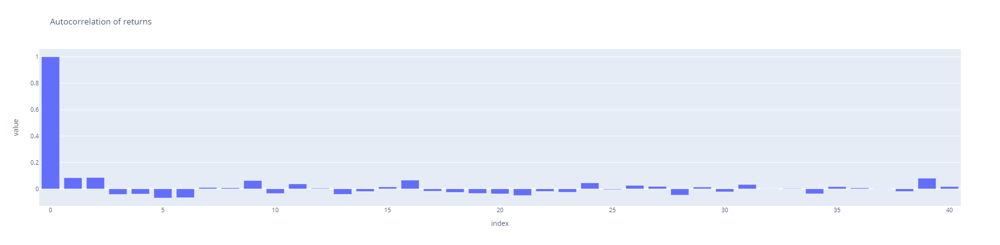

In [27]:
acf_rets = px.bar(pd.DataFrame(sm.tsa.stattools.acf(rets['BA'], fft=False)), title='Autocorrelation of returns', width=1000, height=500)
acf_rets.update_layout(showlegend=False)
acf_rets.show()

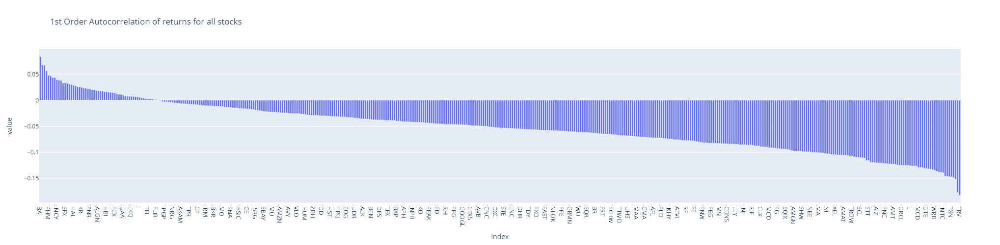

In [28]:
acf = lambda x: sm.tsa.stattools.acf(x, fft=False)[1]
acf_rets_all = pd.DataFrame(rets.apply(acf), columns=['ACF Rets']).dropna()
acf_rets_all.sort_values(ascending=False, by='ACF Rets', inplace=True)
acf_rets_all_plot = px.bar(acf_rets_all, title = '1st Order Autocorrelation of returns for all stocks', width=1000, height=500)
acf_rets_all_plot.update_layout(showlegend=False)
acf_rets_all_plot.show()

# Doesn't look like it!
# What about in the second moment, the volatility?

C:\Users\Tino\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:652: FutureWarning:

The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.



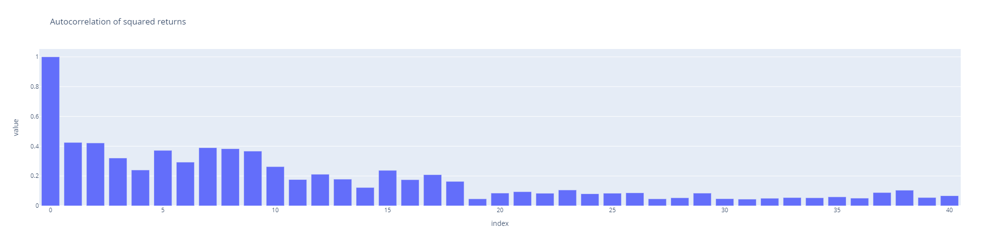

In [29]:
acf_rets_sq = px.bar(pd.DataFrame(sm.tsa.stattools.acf(rets['BA']**2, fft=False)), title='Autocorrelation of squared returns', width=1000, height=500)
acf_rets_sq.update_layout(showlegend=False)
acf_rets_sq.show()

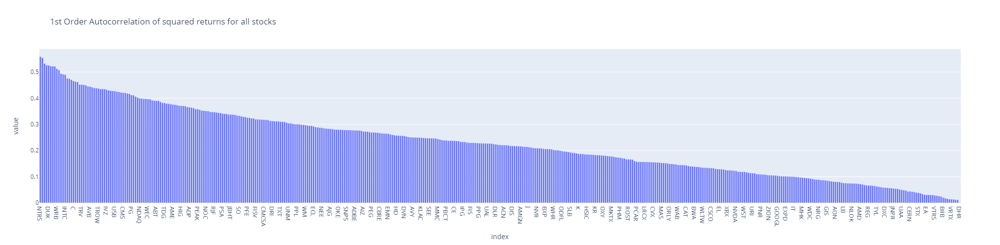

In [30]:
acf = lambda x: sm.tsa.stattools.acf(x, fft=False)[1]
acf_rets_sq_all = pd.DataFrame((rets**2).apply(acf), columns=['ACF Rets Sq']).dropna()
acf_rets_sq_all.sort_values(ascending=False, by='ACF Rets Sq', inplace=True)
acf_rets_sq_all_plot = px.bar(acf_rets_sq_all,  title = '1st Order Autocorrelation of squared returns for all stocks', width=1000, height=500)
acf_rets_sq_all_plot.update_layout(showlegend=False)
acf_rets_sq_all_plot.show()

# This plot is telling us what we already knew; Returns are uncorrelated, but that there is persistence in the variance process

# How can we take this into consideration?
# By using conditional volatility models such as GARCH (Generalized AutoRegressive Conditional Heteroskedastic)

In [31]:
am = arch_model(rets['AAPL'], dist = 't')
garch_output = am.fit(disp='off')
garch_output.summary

<bound method ARCHModelResult.summary of                         Constant Mean - GARCH Model Results                         
Dep. Variable:                         AAPL   R-squared:                      -0.000
Mean Model:                   Constant Mean   Adj. R-squared:                 -0.000
Vol Model:                            GARCH   Log-Likelihood:               -5130.88
Distribution:      Standardized Student's t   AIC:                           10271.8
Method:                  Maximum Likelihood   BIC:                           10301.4
                                              No. Observations:                 2760
Date:                      Wed, Jan 13 2021   Df Residuals:                     2755
Time:                              23:23:23   Df Model:                            5
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------

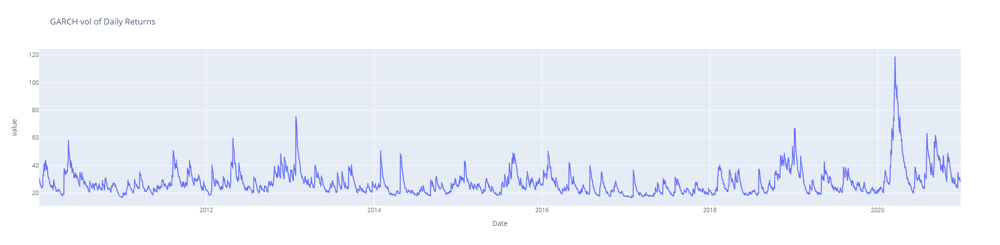

In [32]:
stock_garch =  pd.DataFrame(garch_output.conditional_volatility)*16
garch_plot = px.line(stock_garch, title = 'GARCH vol of Daily Returns', width=1000, height=500)
garch_plot.update_layout(showlegend=False)
garch_plot.show()

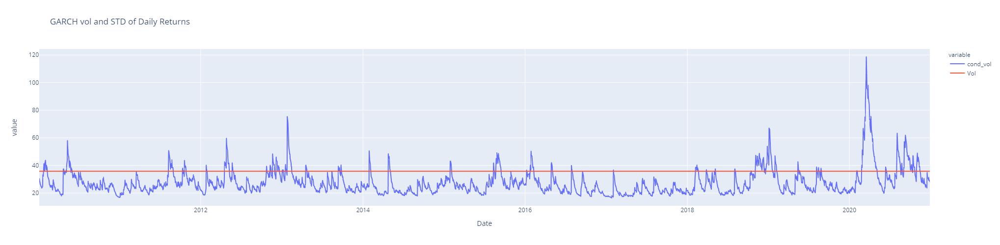

In [33]:
stock_garch['Vol'] = vol_daily.loc['BA',:][0]*16
garch_plot = px.line(stock_garch, title = 'GARCH vol and STD of Daily Returns', width=1000, height=500)
garch_plot.show()

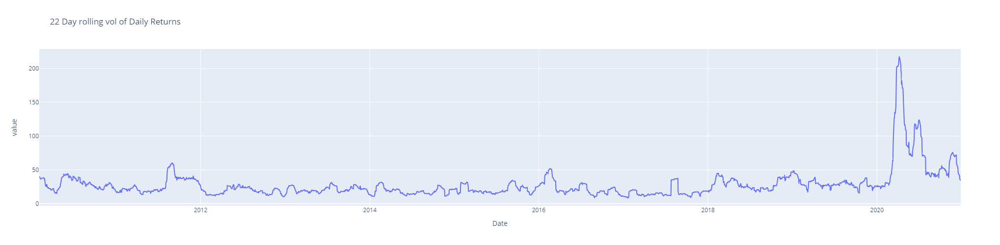

In [34]:
rolling_std_plot = px.line(rets[['BA']].rolling(window=22, min_periods=22).std().dropna()*16, title = '22 Day rolling vol of Daily Returns', width=1000, height=500)
rolling_std_plot.update_layout(showlegend=False)
rolling_std_plot.show()

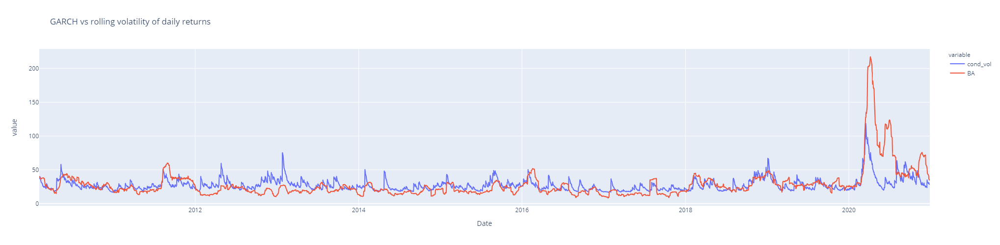

In [35]:
garch_and_rolling_std = pd.concat([pd.DataFrame(garch_output.conditional_volatility*16),rets[['BA']].rolling(window=22, min_periods=22).std()*16], axis=1).dropna()
garch_and_rolling_std_plot = px.line(garch_and_rolling_std, title = 'GARCH vs rolling volatility of daily returns', width=1000, height=500)
garch_and_rolling_std_plot.show()

# The issue with using a rolling window
## All samples are given equal weighting, which can create large distorsions when a large shock enter or exits the sample period

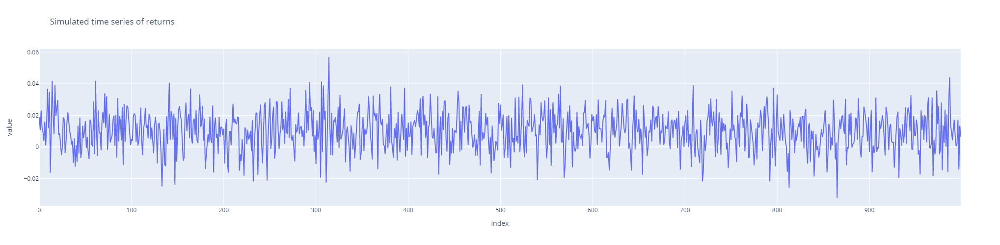

In [36]:
sample_returns = pd.DataFrame(np.random.normal(0.01, 0.20 / 16, 1000), columns = ['Sim Rets'])
sample_returns_fig = px.line(sample_returns, width=1000, height=500, title = 'Simulated time series of returns')
sample_returns_fig.update_layout(showlegend=False)
sample_returns_fig

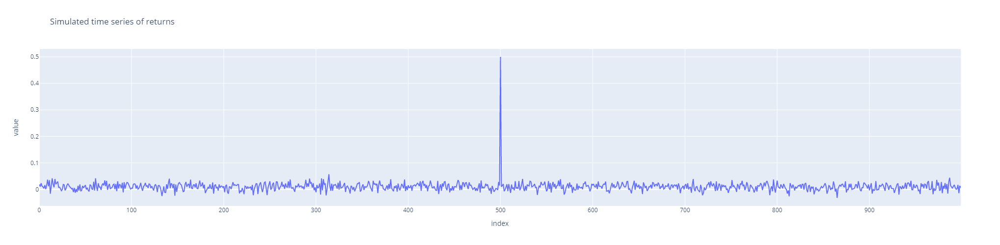

In [37]:
sample_returns.iloc[int(len(sample_returns)/2)] = 0.5
sample_returns_fig = px.line(sample_returns, width=1000, height=500, title = 'Simulated time series of returns')
sample_returns_fig.update_layout(showlegend=False)
sample_returns_fig

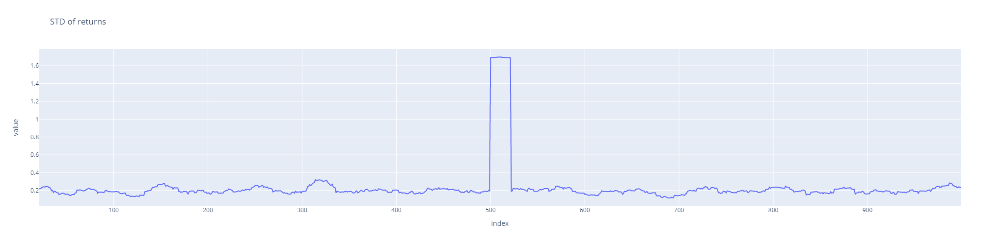

In [38]:
sample_returns.std() * 16
sample_returns_vol = px.line(sample_returns.rolling(window=22, min_periods=22).std().dropna()*16, title = 'STD of returns',  width=1000, height=500)
sample_returns_vol.update_layout(showlegend=False)
sample_returns_vol.show()

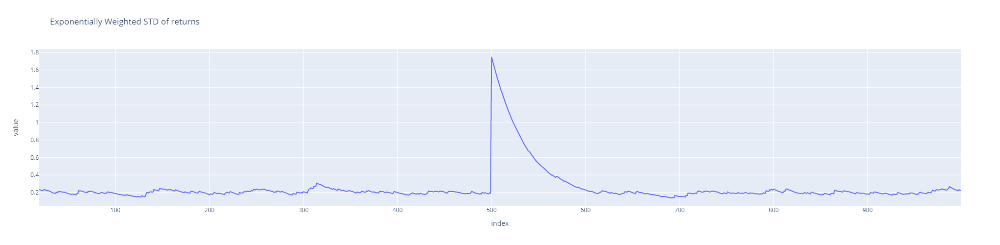

In [39]:
sample_returns_eq_vol = px.line(sample_returns.ewm(alpha=0.05, min_periods=20).std().dropna()*16, title = 'Exponentially Weighted STD of returns',  width=1000, height=500)
sample_returns_eq_vol.update_layout(showlegend=False)
sample_returns_eq_vol.show()

## Can we fit GARCH to the above then?
## Let's try:

In [40]:
shock_garch = arch_model(sample_returns*100, dist = 't')
garch_output_shock = shock_garch.fit(disp='off')
garch_output_shock.summary

<bound method ARCHModelResult.summary of                         Constant Mean - GARCH Model Results                         
Dep. Variable:                     Sim Rets   R-squared:                      -0.000
Mean Model:                   Constant Mean   Adj. R-squared:                 -0.000
Vol Model:                            GARCH   Log-Likelihood:               -1679.32
Distribution:      Standardized Student's t   AIC:                           3368.64
Method:                  Maximum Likelihood   BIC:                           3393.18
                                              No. Observations:                 1000
Date:                      Wed, Jan 13 2021   Df Residuals:                      995
Time:                              23:48:39   Df Model:                            5
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------

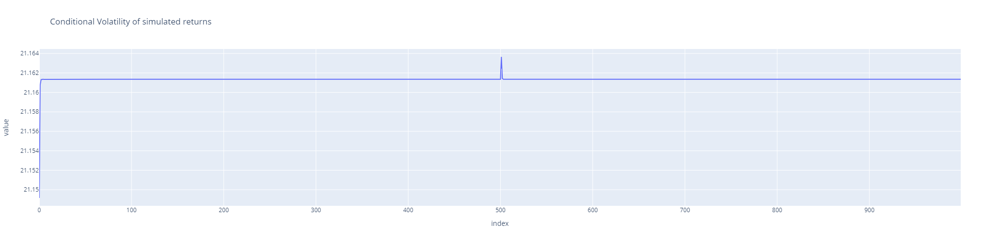

In [41]:
garch_sim_rets_plot = px.line(garch_output_shock.conditional_volatility*16, title = 'Conditional Volatility of simulated returns',  width=1000, height=500)
garch_sim_rets_plot.update_layout(showlegend=False)
garch_sim_rets_plot.show()

# Introducing Copulas and DCC, Dynamic Conditional Correlation
## The structure is very similar to GARCH, so the model still has a memory component, and each correlation point is conditional on new information being received. The difference is that we model correlation in the volatilities, rather than in the returns.
## We are actually using a Copula here, which allows us to use time series with different distributions. An example of this would be trying to work out the correlation between time spent on Amazon.com.au, and money spent.

In [ ]:
from scipy.stats import gamma
from scipy.stats import norm
from scipy.stats import t
from scipy.stats import beta
np.random.seed(seed=5)
mean = [0,0]
rho = 0.8
cov = [[1,rho],[rho,1]] # diagonal covariance, points lie on x or y-axis
import matplotlib.pyplot as plt
norm_1,norm_2 = np.random.multivariate_normal(mean,cov,1000).T
unif_1 = norm.cdf(norm_1)
unif_2 = norm.cdf(norm_2)

In [ ]:
# pd.concat([pd.DataFrame(unif_1), pd.DataFrame(unif_2)], axis=1).corr()

# Time spent on website

In [ ]:
website_time = pd.DataFrame(gamma.ppf(unif_1, a=2, scale=5))
website_spend =  pd.DataFrame(beta.ppf(unif_2,a=0.5, b=0.5, loc=5, scale=100))
# website_spend = pd.DataFrame(abs(t.ppf(unif_2, df = 4, loc = 25 ,scale=4)))
join_time_spend = pd.concat([website_time, website_spend], axis=1)
join_time_spend.columns = ['Time', 'Cash']
gamma_dist  = ff.create_distplot([website_time.values.reshape(-1)], group_labels = [' '])
gamma_dist.update_layout(showlegend=False, title_text='Time Spent on Website', width=1000, height=500)
gamma_dist.show()

## Dollars spent on website

In [ ]:
t_dist  = ff.create_distplot([website_spend.values.reshape(-1)], group_labels = [' '])
t_dist.update_layout(showlegend=False, title_text='$$ Spent on Website', width=1000, height=500)
t_dist.show()

## Scatter plot of time spent on website vs $$ spent

In [ ]:
fig = px.scatter(join_time_spend, x = 'Time', y='Cash', width=1000, height=500)
fig.show()

In [ ]:
print("Corrlation between time and $$ is: " + str(round(join_time_spend.corr().values[0][1],4)))

## Transforming distributions to make our lives easier

In [ ]:
time_cdf =  pd.DataFrame(gamma.cdf(website_time.values, a = 2, scale=5))
time_cdf_vs_original = pd.concat([time_cdf, website_time], axis=1)
time_cdf_vs_original.columns = ['CDF', 'Original']

time_cdf_vs_original_plot = px.scatter(time_cdf_vs_original, x = 'Original', y='CDF', width=1000, height=500, title='Gamma Cumulative Distribution Function for Time')
time_cdf_vs_original_plot.show()

In [ ]:
time_cdf =  pd.DataFrame(gamma.cdf(website_time.values, a = 2, scale=5))
time_cdf_plot  = ff.create_distplot([time_cdf.values.reshape(-1)], group_labels = [' '], show_curve=False, bin_size=0.05)
time_cdf_plot.update_layout(showlegend=False, title_text='Uniform distribution of time spent on site', width=1000, height=500)
time_cdf_plot.show()

In [ ]:
dollar_cdf = pd.DataFrame(beta.cdf(website_spend.values,a=0.5, b=0.5, loc=5, scale=100))
dollar_cdf_vs_original = pd.concat([dollar_cdf, website_spend], axis=1)
dollar_cdf_vs_original.columns = ['CDF', 'Original']

dollar_cdf_vs_original_plot = px.scatter(dollar_cdf_vs_original, x = 'Original', y='CDF', width=1000, height=500, title='Beta Cumulative Distribution Function for $$')
dollar_cdf_vs_original_plot.show()

In [ ]:
dollar_cdf_plot  = ff.create_distplot([dollar_cdf.values.reshape(-1)], group_labels = [' '], show_curve=False, bin_size=0.05)
dollar_cdf_plot.update_layout(showlegend=False, title_text='Uniform distribution of $$ spent on site', width=1000, height=500)
dollar_cdf_plot.show()

In [ ]:
join_time_spend_uniform = pd.concat([dollar_cdf, time_cdf], axis=1)
join_time_spend_uniform.columns = ['Time', 'Cash']

time_v_money_uniform = px.scatter(join_time_spend_uniform, x = 'Time', y='Cash', width=1000, height=500)
time_v_money_uniform.show()

In [ ]:
print("Corrlation between uniform time and $$ is: " + str(round(join_time_spend_uniform.corr().values[0][1],4)))

# Now we know about transormations, we can apply them to financial data

In [ ]:
def vecl(matrix):
    lower_matrix = np.tril(matrix,k=-1)
    array_with_zero=np.matrix(lower_matrix).A1

    array_without_zero = array_with_zero[array_with_zero!=0]

    return array_without_zero

In [ ]:
def garch_t_to_u(rets, res):
    mu = res.params['mu']
    nu = res.params['nu']
    est_r = rets - mu
    h = res.conditional_volatility
    std_res = est_r / np.sqrt(h)
    udata = t.cdf(std_res, nu)
    return udata

In [ ]:
def loglike_norm_dcc_copula(theta, udata):
    N, T = np.shape(udata)
    llf = np.zeros((T,1))
    trdata = np.array(norm.ppf(udata).T, ndmin=2)
    
    
    Rt, veclRt =  dcceq(theta,trdata)

    for i in range(0,T):
        llf[i] = -0.5* np.log(np.linalg.det(Rt[:,:,i]))
        llf[i] = llf[i] - 0.5 *  np.matmul(np.matmul(trdata[i,:] , (np.linalg.inv(Rt[:,:,i]) - np.eye(N))) ,trdata[i,:].T)
    llf = np.sum(llf)

    return -llf

In [ ]:
def dcceq(theta,trdata):
    T, N = np.shape(trdata)

    a, b = theta
    
    if min(a,b)<0 or max(a,b)>1 or a+b > .999999:
        a = .9999 - b
        
    Qt = np.zeros((N, N ,T))

    Qt[:,:,0] = np.cov(trdata.T)

    Rt =  np.zeros((N, N ,T))
    veclRt =  np.zeros((T, int(N*(N-1)/2)))
    
    Rt[:,:,0] = np.corrcoef(trdata.T)
    
    for j in range(1,T):
        Qt[:,:,j] = Qt[:,:,0] * (1-a-b)
        Qt[:,:,j] = Qt[:,:,j] + a * np.matmul(trdata[[j-1]].T, trdata[[j-1]])
        Qt[:,:,j] = Qt[:,:,j] + b * Qt[:,:,j-1]
        Rt[:,:,j] = np.divide(Qt[:,:,j] , np.matmul(np.sqrt(np.array(np.diag(Qt[:,:,j]), ndmin=2)).T , np.sqrt(np.array(np.diag(Qt[:,:,j]), ndmin=2))))
    
    for j in range(0,T):
        veclRt[j, :] = vecl(Rt[:,:,j].T)
    return Rt, veclRt

In [ ]:
model_parameters = {}
udata_list = []

def run_garch_on_return(rets, udata_list, model_parameters):
    for x in rets:
        am = arch_model(rets[x], dist = 't')
        short_name = x.split()[0]
        model_parameters[short_name] = am.fit(disp='off')
        udata = garch_t_to_u(rets[x], model_parameters[short_name])
        udata_list.append(udata)
    return udata_list, model_parameters

## Initially run GARCH on the individual time series, and transform them to the uniform distribution

In [ ]:
udata_list, model_parameters = run_garch_on_return(rets.iloc[:,:5].dropna(), udata_list, model_parameters)

## Setup our DDC Model, and then run it on our 5 securities

In [ ]:
cons = ({'type': 'ineq', 'fun': lambda x:  -x[0]  -x[1] +1})
bnds = ((0, 0.5), (0, 0.9997))

In [ ]:
%time opt_out = minimize(loglike_norm_dcc_copula, np.array([0.01, 0.95]), args = (udata_list,), bounds=bnds, constraints=cons)

In [ ]:
print(opt_out.success)
print(opt_out.x)

In [ ]:
llf  = loglike_norm_dcc_copula(opt_out.x, udata_list)
llf

In [ ]:
trdata = np.array(norm.ppf(udata_list).T, ndmin=2)
Rt, veclRt = dcceq(opt_out.x, trdata)

In [ ]:
stock_names = [x.split()[0] for x in rets.iloc[:,:5].columns]

In [ ]:
corr_name_list = []
for i, name_a in enumerate(stock_names):
    if i == 0:
        pass
    else:
        for name_b in stock_names[:i]:
            corr_name_list.append(name_a + "-" + name_b)

## AAPL and ABC Look interesting

In [ ]:
dcc_corr = pd.DataFrame(veclRt, index = rets.iloc[:,:5].dropna().index, columns= corr_name_list)
dcc_plot = px.line(dcc_corr, title = 'Dynamic Conditional Correlation plot', width=1000, height=500)
dcc_plot.show()

In [ ]:
garch_vol_df = pd.concat([pd.DataFrame(model_parameters[x].conditional_volatility/100)*1600 for x in model_parameters], axis=1)
garch_vol_df.columns = stock_names

In [ ]:
px.line(garch_vol_df, title='GARCH Conditional Volatility', width=1000, height=500).show()

In [ ]:
px.scatter(garch_vol_df, x = 'AAPL', y='AAL', width=1000, height=500, title='GARCH Volatility').show()

In [ ]:
px.line(np.log((1+rets.iloc[:,:5].dropna()/100).cumprod()), title='Cumulative Returns', width=1000, height=500).show()

In [ ]:
rets.loc[:, ['AAPL','AAL']].corr()

In [ ]:
a1corr = rets.loc[:, ['AAPL','AAL']].corr().values[0][1]

In [ ]:
a1dcc = pd.DataFrame(veclRt[:,5],index = rets.iloc[:,:5].dropna().index)
a1dcc.columns = ['DCC']
a1dcc['corr'] = a1corr

In [ ]:
px.line(a1dcc, title = 'DCC vs unconditional correlation', width=1000, height=500).show()

In [ ]:
import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs
import statsmodels.stats as sms

# When looking at backtesting, it is important to not overfit a time series. How do we do this?
# By simulating data with similar characteristics, and seeing if out model/strategy still perform well
## Simulation using Cholesky Decomposition in order to introduce correlations between assets

In [ ]:
corr = np.array([[1, 0.7, 0.7], [0.7, 1, 0.7], [0.7, 0.7, 1]])

corr

In [ ]:
chol = np.linalg.cholesky(corr)
chol

corr = chol * chol.T

In [ ]:
np.matmul(chol, chol.T)

In [ ]:
rand_data = np.random.normal(size=(3,1000))
rand_data

In [ ]:
pd.DataFrame(rand_data.T).corr()

In [ ]:
sim_corr_rets = pd.DataFrame(np.matmul(chol, rand_data), index = ['A', 'B', 'C']).T/100

In [ ]:
sim_corr_rets.head()

In [ ]:
sim_cum_rets_plot = px.line((1+sim_corr_rets).cumprod(), title='Simulated returns with correlation', width=1000, height=500)
sim_cum_rets_plot.show()

In [ ]:
sim_corr_rets.corr()